## Computer Vision: Object Detection

### Dataset: Aquarium <br>
### Model: YOLOv5 (by Ultralytics)

In [59]:
from google.colab import drive
drive.mount('/content/drive')

# Enter project directory.
%cd /content/drive/MyDrive/project_aquarium/

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/project_aquarium


In [ ]:
%pip install -U kaleido -q roboflow

import os
import sys
sys.path.insert(0, "..")
import src.dataset as srd
import src.show_sample as srs
import src.train_infer as srti

import kaleido
import cv2
import plotly.graph_objects as go
from IPython.display import Image, display

In [ ]:
# Install YOLOv5 dependencies.
if not os.path.exists('yolov5'):
    !git clone https://github.com/ultralytics/yolov5

%cd yolov5/
%pip install -qr requirements.txt  # ignore errors

In [4]:
import utils
display = utils.notebook_init()

YOLOv5 🚀 v7.0-53-g65071da Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 23.3/78.2 GB disk)


### Data Preparation

In [5]:
%cd ..
# Download dataset from Roboflow in format 'YOLOv5 PyTorch'
# (i.e. with .txt annotations and yaml config).
srd.download_data(api_key="jnMdAmS2FkX9j96oVEIt", workspace="aquariumdataset",
                  project_name="aquarium-dataset-78xdt", version=10)

/content/drive/MyDrive/project_aquarium
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to input/data/ in yolov5pytorch:: 100%|██████████| 2120/2120 [00:12<00:00, 163.96it/s]


_Dataset folder structure after downloading:_


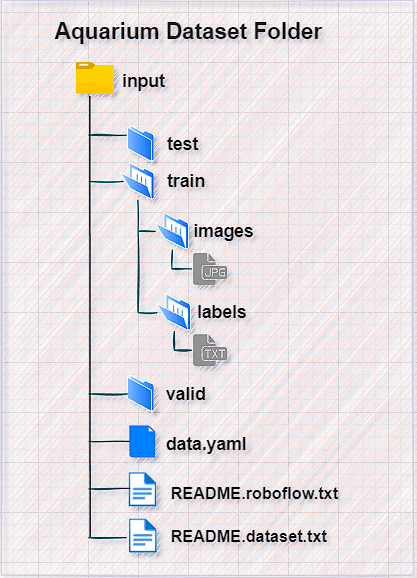

In [6]:
Image(filename="notebooks/imgs/data_folder_structure.png", width=300)

In [7]:
# Define paths to data directories.
train_imgs_dir, val_imgs_dir, test_imgs_dir = srd.define_paths2imgs()
train_labels_dir, val_labels_dir, test_labels_dir = srd.define_paths2labels()

### EDA

Dataset summary, class breakdown, and bounding box annotations

In [8]:
srd.count_total(train_imgs_dir,
                val_imgs_dir,
                test_imgs_dir)

The dataset consists of 1054 images.
-------------------
Train: 743 images.
Validation: 207 images.
Test: 104 images.


In [9]:
num_classes, classes = srd.get_classes()

print(f"The dataset encompasses {num_classes} classes:",
      classes, sep="\n")

The dataset encompasses 7 classes:
['fish', 'jellyfish', 'penguin', 'puffin', 'shark', 'starfish', 'stingray']


In [10]:
# Dicts with class breakdown by ground truth bboxes.
train_classes = srd.get_class_breakdown(classes, train_imgs_dir)
val_classes = srd.get_class_breakdown(classes, val_imgs_dir)
test_classes = srd.get_class_breakdown(classes, test_imgs_dir)

# Create dataframe with the total number
# of annotations for each class.
df = srd.count_annotations(train_classes, val_classes, test_classes)

# Total number of annotations.
print(f"Number of annotations: {df.amount.sum()}")

Number of annotations: 6284


In [11]:
# Stats for train and valid sets.
srd.get_stats(train_classes, "Training Set Stats")
print()
srd.get_stats(val_classes, "Validation Set Stats")

Training Set Stats
--------------------
Class breakdown (by ground truth bboxes):
fish: 1970
jellyfish: 594
penguin: 593
puffin: 402
shark: 305
starfish: 268
stingray: 269

Validation Set Stats
--------------------
Class breakdown (by ground truth bboxes):
fish: 536
jellyfish: 176
penguin: 90
puffin: 106
shark: 88
starfish: 147
stingray: 72


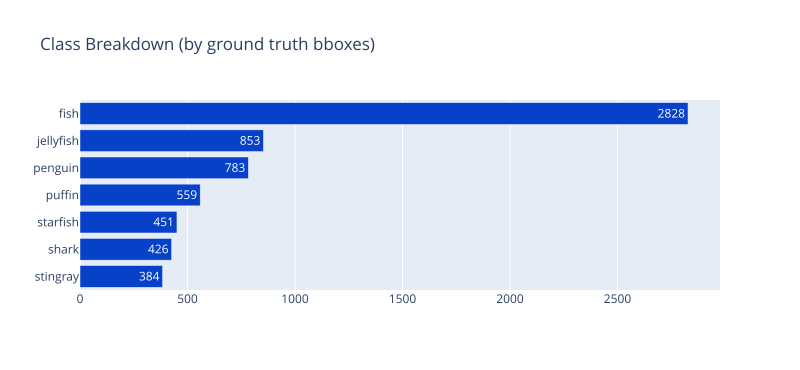

In [12]:
srd.visualize_classes(df.amount, df.label,
                      name="Class Breakdown (by ground truth bboxes)",
                      dir_save="notebooks/imgs/")

Background images with no objects

In [13]:
# Find imgs with no objects by verifying
# .txt files with ground truth labels.
empty_imgs = srd.is_img_empty(train_labels_dir)

print(f"{len(empty_imgs)} background images with no objects.")

12 background images with no objects.


Shape of the image: (680, 1024, 3)



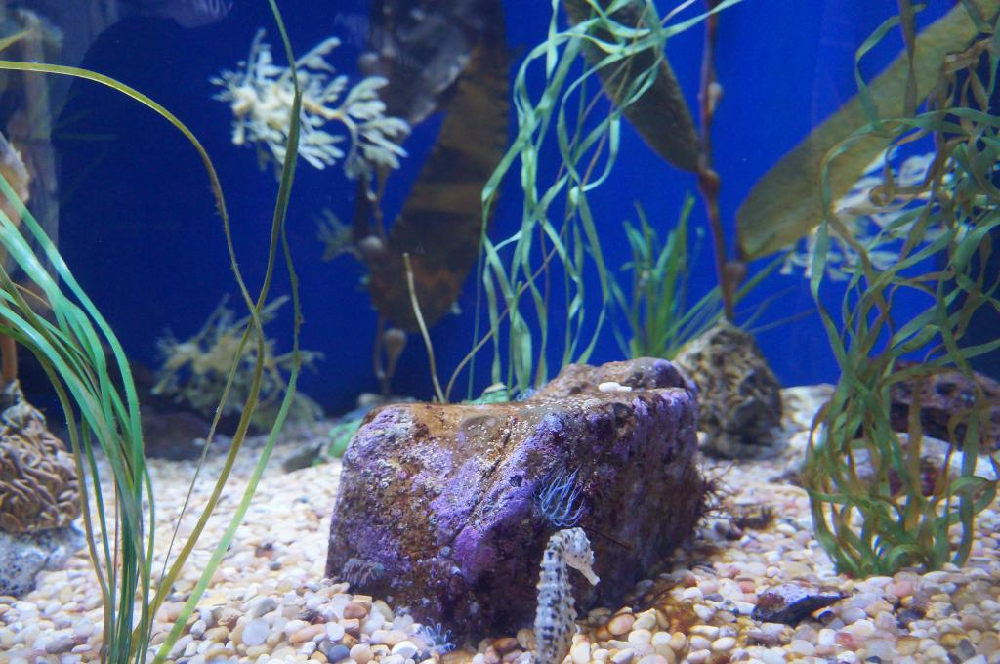

In [14]:
image = os.path.join(train_imgs_dir, f"{empty_imgs[7]}.jpg")
image_shape = cv2.imread(image)

print(f"Shape of the image: {image_shape.shape}\n")
Image(filename=image, width=550)

Image examples

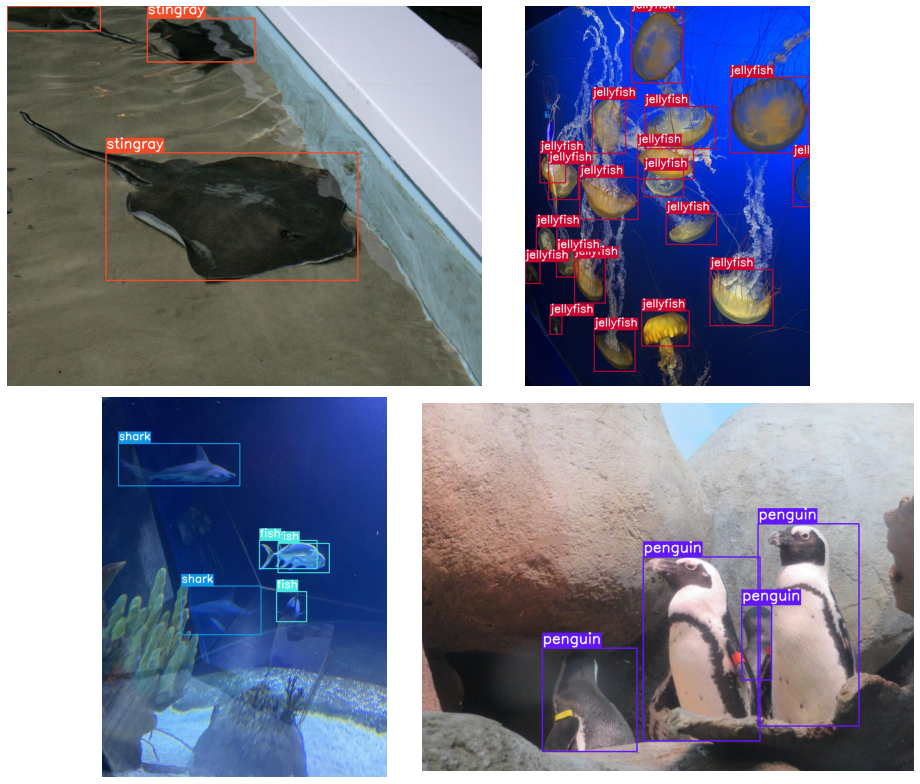

In [18]:
srs.plot(
    image_paths=f'{train_imgs_dir}*',
    label_paths=f'{train_labels_dir}*',
    class_names=classes,
    num_samples=4)

### YOLOv5 (by Ultralytics)

YOLOv5 is a family of object detection architectures and models pretrained on the COCO dataset.

_The specifications for YOLO format are as follows:_

- each object should have its own row in the txt file;
- each row should have the pattern: class x_center y_center width height;
- class number must be an int and starts from 0;
- x_center, y_center, width, height must be in normalized form (range from 0 to 1).

In [19]:
# Logging
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir models/runs/train/

In [20]:
# Since YOLOv5 model (by Ultralytics) searches for dataset inside
# the root folder 'yolov5', tweak paths to img folders in the .yaml file.
srti.change_paths()
%cat input/data/data.yaml

names:
- fish
- jellyfish
- penguin
- puffin
- shark
- starfish
- stingray
nc: 7
roboflow:
  license: CC BY 4.0
  project: aquarium-dataset-78xdt
  url: https://universe.roboflow.com/aquariumdataset/aquarium-dataset-78xdt/dataset/10
  version: 10
  workspace: aquariumdataset
test: ../input/data/test/images
train: ../input/data/train/images
val: ../input/data/valid/images


### Training

During training, the YOLOv5 training pipeline creates batches of training data with augmentations.

In [21]:
epochs = 40
batch_size = 16
runs_train_dir = "models/runs/train/"
runs_infer_dir = "models/runs/detect/"

#### Logging

In [22]:
monitor_tensorboard()

<IPython.core.display.Javascript object>

-------
#### **Baseline: YOLOv5s** (with default settings by Ultralytics)

In [23]:
%cat yolov5/models/yolov5s.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [24]:
%%time

# Folder for saving results.
results_5s = srti.set_results_dir("yolo5s")

# # By default, --hyp yolov5/data/hyps/hyp.scratch-low.yaml
!python yolov5/train.py --data input/data/data.yaml --weights yolov5/yolov5s.pt \
  --img 640 --epochs {epochs} --batch-size {batch_size} --name {results_5s} \
  --cache --project {runs_train_dir}

Outputs are saved to directory: results_yolo5s ...
train: weights=yolov5/yolov5s.pt, cfg=, data=input/data/data.yaml, hyp=yolov5/data/hyps/hyp.scratch-low.yaml, epochs=40, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=models/runs/train/, name=results_yolo5s, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-53-g65071da Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=

Ground truth augmented training data



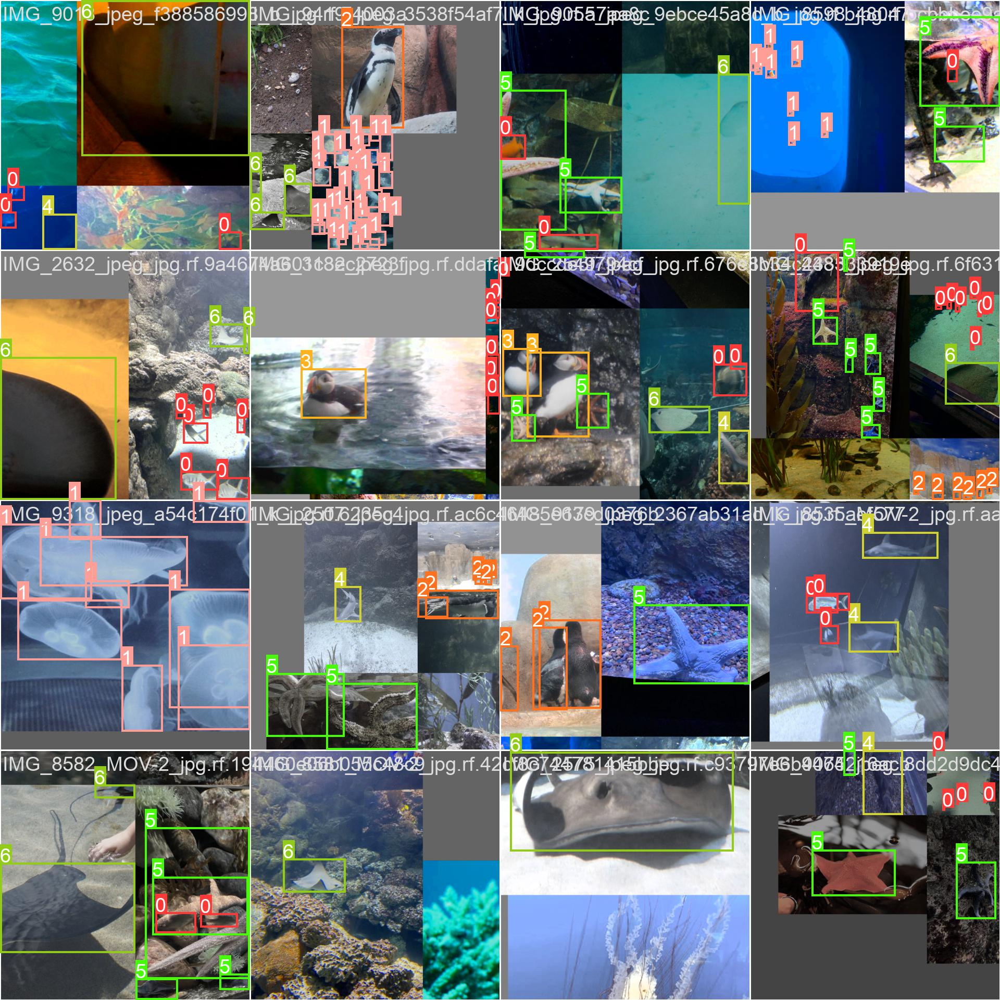

In [25]:
srti.visualize(results_5s, 2, val=False)

Validation: ground truth data



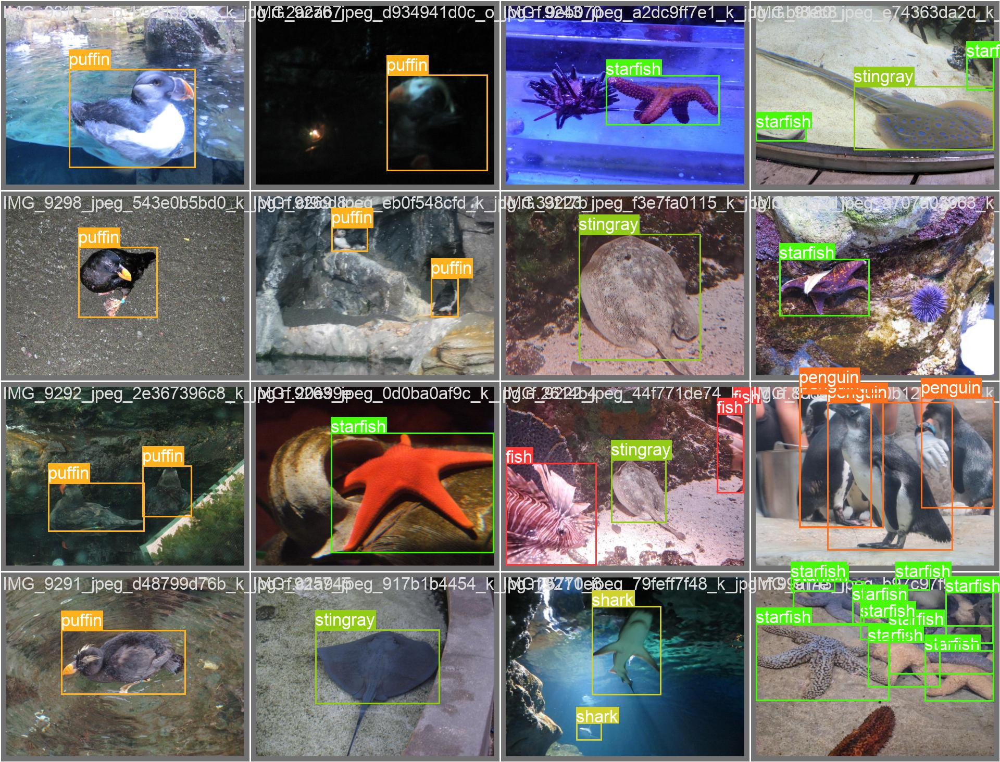

In [26]:
srti.visualize(results_5s, 2, val=True)

Validation: predicted data



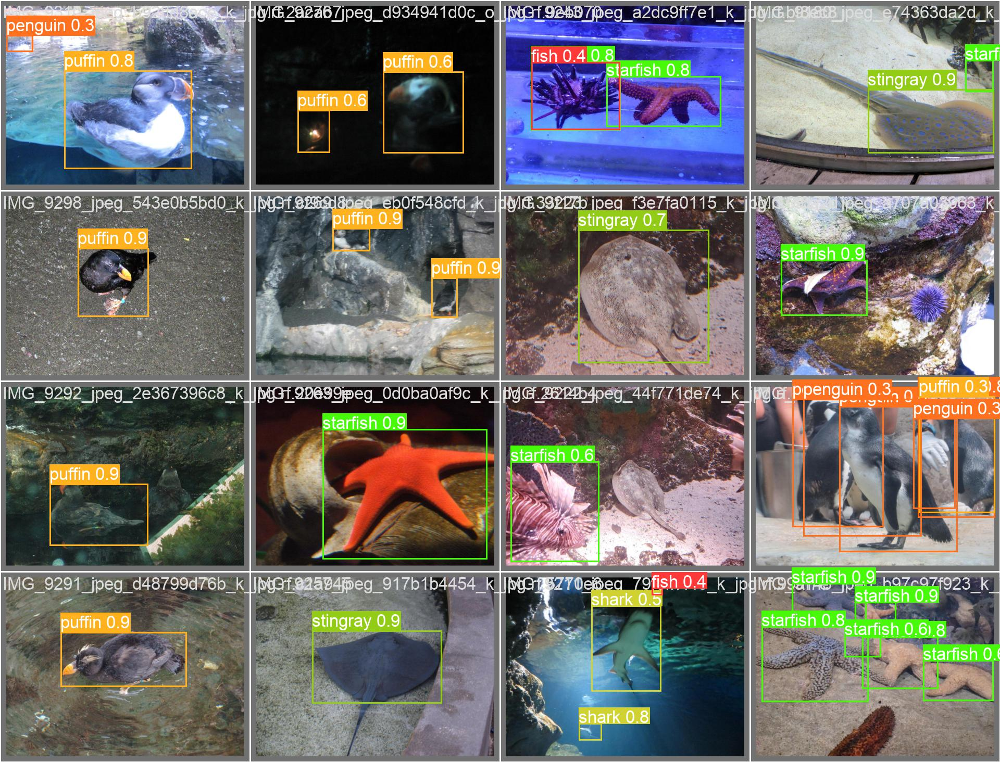

In [27]:
srti.visualize(results_5s, 2, val=True, labels=False)

In [28]:
# Save the best model to models storage and return path.
model_yolo5s = srti.move_best_model(results_5s)

Inference on test

In [29]:
!python yolov5/detect.py --weights {model_yolo5s} --source {test_imgs_dir} \
  --img 640 --conf 0.4 --name {results_5s} --project {runs_infer_dir}

detect: weights=['models/best_models_storage/best_yolo5s.pt'], source=input/data/test/images/, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=models/runs/detect/, name=results_yolo5s, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-53-g65071da Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7029004 parameters, 0 gradients, 15.8 GFLOPs
image 1/104 /content/drive/MyDrive/project_aquarium/input/data/test/images/IMG_2280_jpeg_jpg.rf.a0dff6c20b40fb134b7e26af712138a9.jpg: 640x480 55 fishs, 11.7ms
image 2/104 /content/drive/MyDrive/project_aquarium/input/data/test/images/IMG_2289_jpeg_jpg.rf.c1810d9dac260d89bdaa0dd693058115.jpg: 640x480 1 puff

In [30]:
# Get the mAP.
!python yolov5/val.py --data input/data/data.yaml --weights {model_yolo5s} \
  --batch-size 16 --task test --name test_mAP --project models/runs/detect/results_yolo5s

val: data=input/data/data.yaml, weights=['models/best_models_storage/best_yolo5s.pt'], batch_size=16, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=models/runs/detect/results_yolo5s, name=test_mAP, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-53-g65071da Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7029004 parameters, 0 gradients, 15.8 GFLOPs
test: Scanning /content/drive/MyDrive/project_aquarium/input/data/test/labels... 104 images, 0 backgrounds, 0 corrupt: 100% 104/104 [00:00<00:00, 211.79it/s]
test: New cache created: /content/drive/MyDrive/project_aquarium/input/data/test/labels.cache
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 7/7 [00:04<00:00,  1.56it/s]
                   all        104        66

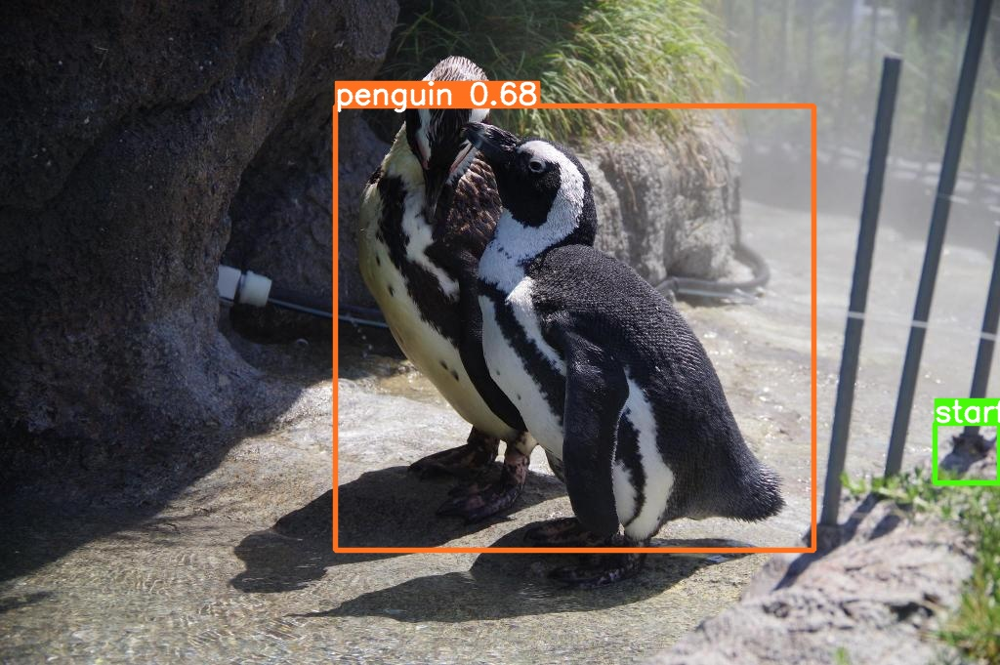

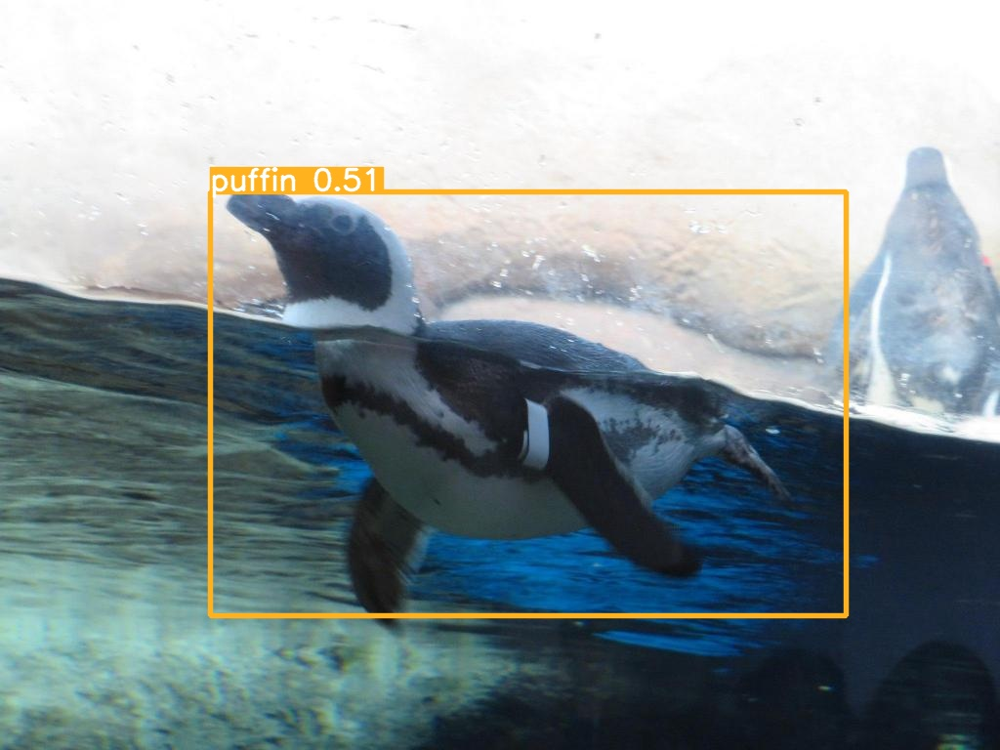

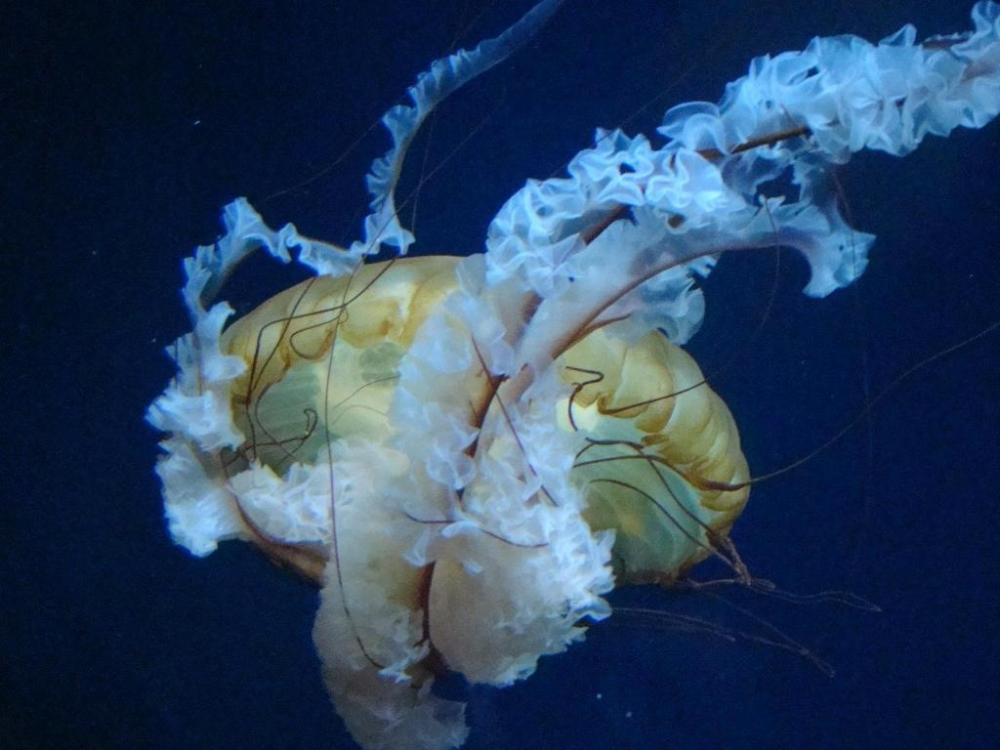

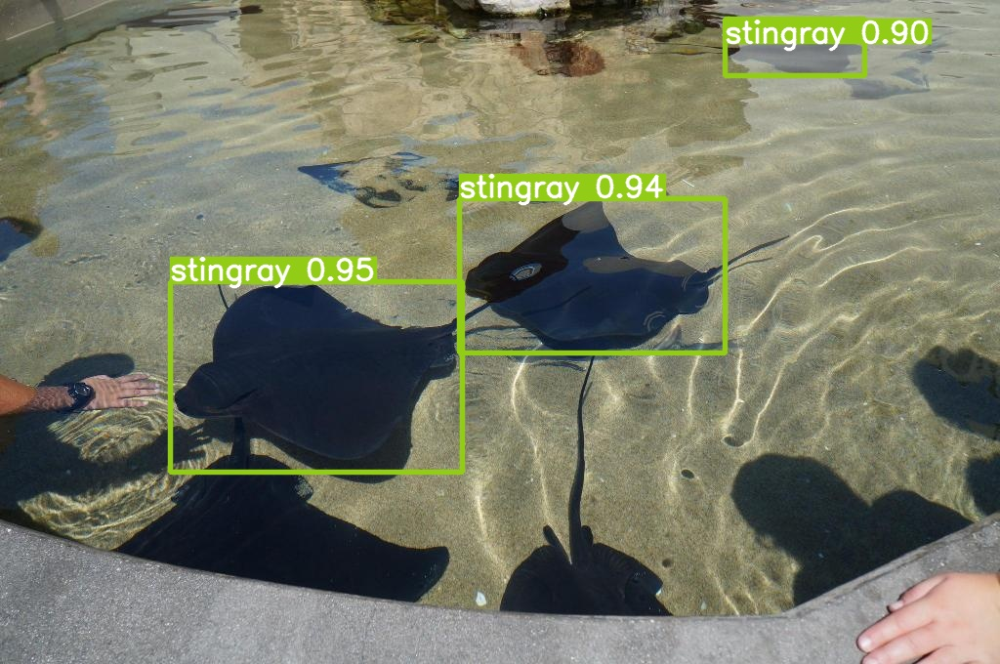

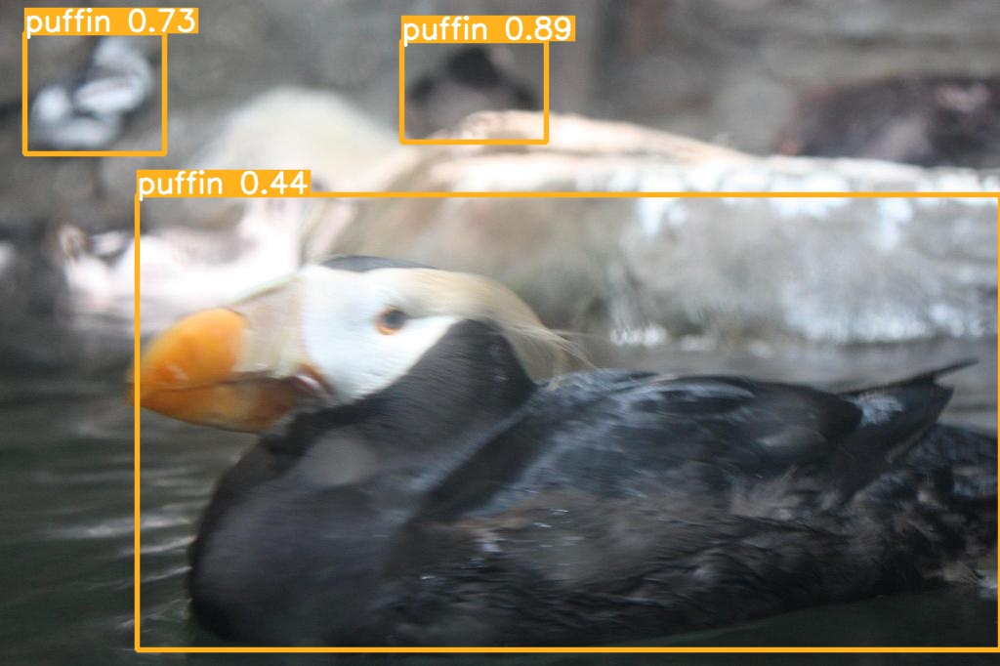

In [32]:
# Visualize five test images.
srti.visualize_test_imgs("models/runs/detect/results_yolo5s")

---------
#### **YOLO5m**

In [33]:
%cat yolov5/models/yolov5m.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.67  # model depth multiple
width_multiple: 0.75  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [34]:
%%time

# Folder for saving results.
results_5m = srti.set_results_dir("yolo5m")

!python yolov5/train.py --data input/data/data.yaml --weights yolov5/yolov5m.pt \
    --img 640 --epochs {epochs} --batch-size {batch_size} --name {results_5m} \
    --cache --project {runs_train_dir} --hyp yolov5/data/hyps/hyp.scratch-med.yaml

Outputs are saved to directory: results_yolo5m ...
train: weights=yolov5/yolov5m.pt, cfg=, data=input/data/data.yaml, hyp=yolov5/data/hyps/hyp.scratch-med.yaml, epochs=40, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=models/runs/train/, name=results_yolo5m, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-53-g65071da Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.3, cls_pw=1.0, obj=0

Ground truth augmented training data



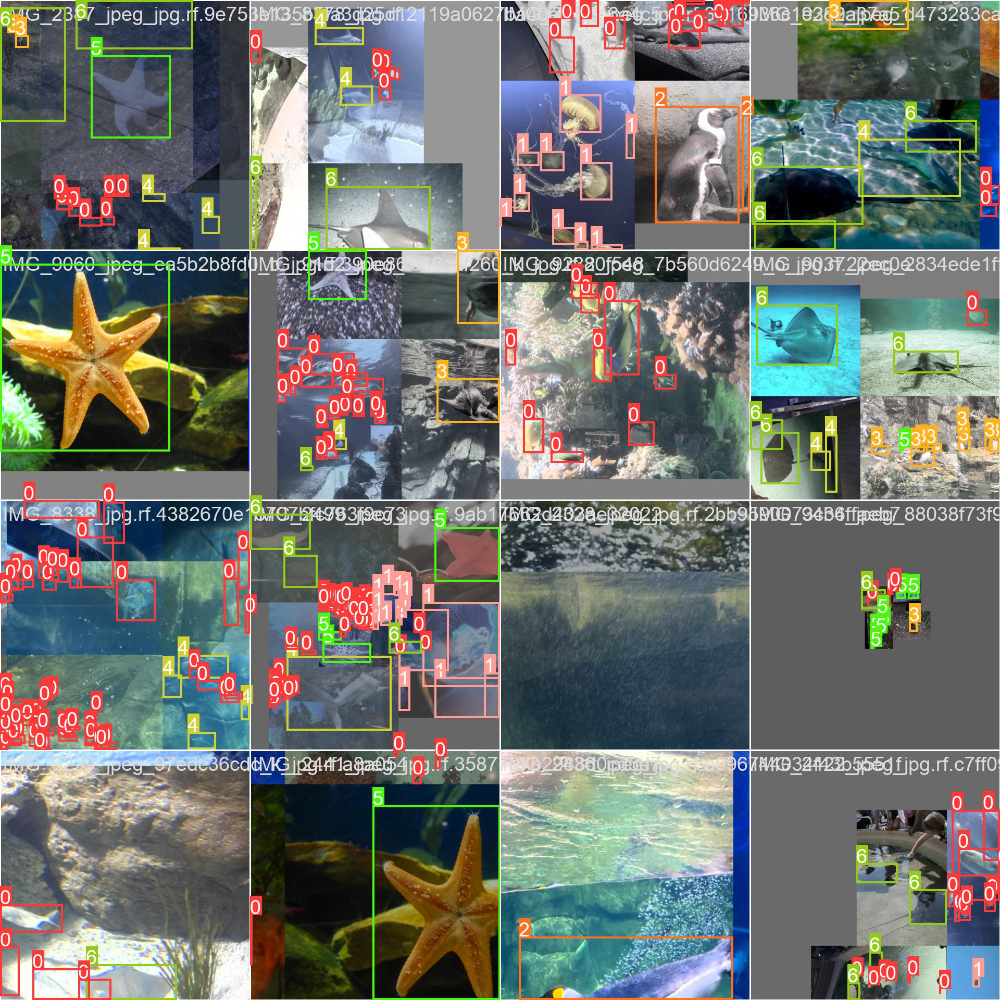

In [35]:
srti.visualize(results_5m, 0, val=False)

Validation: ground truth data



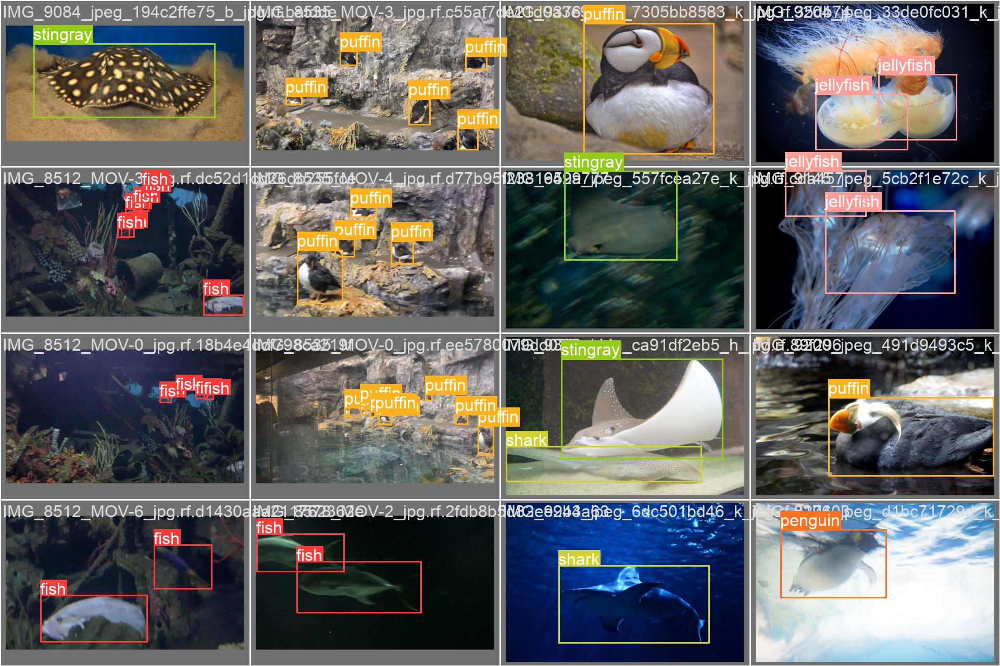

In [36]:
srti.visualize(results_5m, 0, val=True)

Validation: predicted data



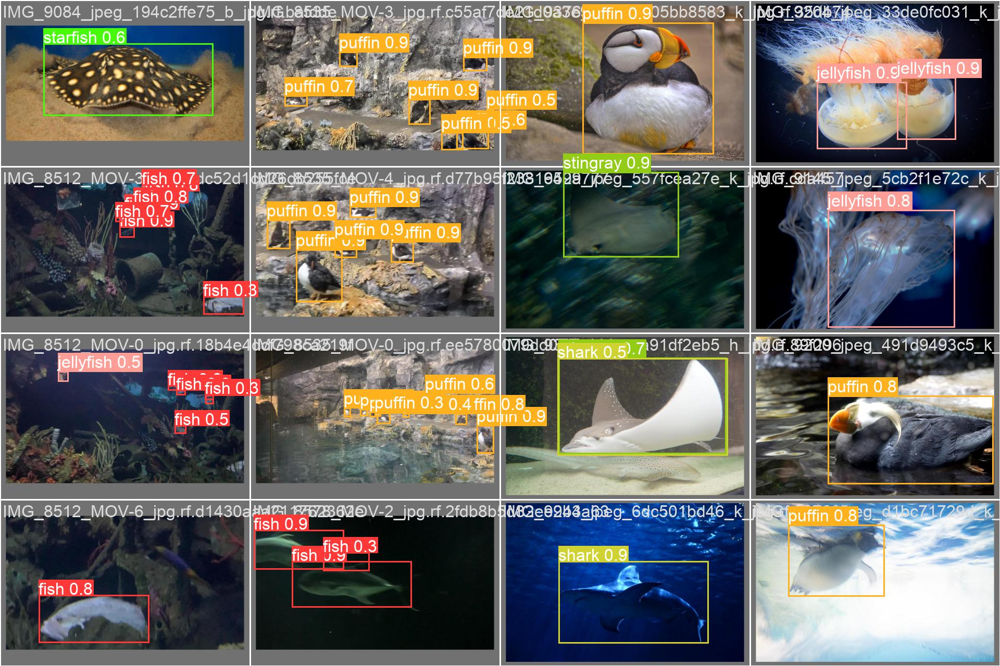

In [37]:
srti.visualize(results_5m, 0, val=True, labels=False)

In [38]:
# Save the best model to models storage and return path.
model_yolo5m = srti.move_best_model(results_5m)

Inference on test

In [39]:
!python yolov5/detect.py --weights {model_yolo5m} --source {test_imgs_dir} \
  --img 640 --conf 0.4 --name {results_5m} --project {runs_infer_dir}

detect: weights=['models/best_models_storage/best_yolo5m.pt'], source=input/data/test/images/, data=yolov5/data/coco128.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=models/runs/detect/, name=results_yolo5m, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-53-g65071da Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 20877180 parameters, 0 gradients, 47.9 GFLOPs
image 1/104 /content/drive/MyDrive/project_aquarium/input/data/test/images/IMG_2280_jpeg_jpg.rf.a0dff6c20b40fb134b7e26af712138a9.jpg: 640x480 64 fishs, 22.1ms
image 2/104 /content/drive/MyDrive/project_aquarium/input/data/test/images/IMG_2289_jpeg_jpg.rf.c1810d9dac260d89bdaa0dd693058115.jpg: 640x480 1 puf

In [40]:
# Get the mAP.
!python yolov5/val.py --data input/data/data.yaml --weights {model_yolo5m} \
 --batch-size 16 --task test --name test_mAP --project models/runs/detect/results_yolo5m

val: data=input/data/data.yaml, weights=['models/best_models_storage/best_yolo5m.pt'], batch_size=16, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=models/runs/detect/results_yolo5m, name=test_mAP, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-53-g65071da Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 20877180 parameters, 0 gradients, 47.9 GFLOPs
test: Scanning /content/drive/MyDrive/project_aquarium/input/data/test/labels.cache... 104 images, 0 backgrounds, 0 corrupt: 100% 104/104 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 7/7 [00:05<00:00,  1.36it/s]
                   all        104        668      0.868       0.76      0.823       0.57
                  fish        104        322      

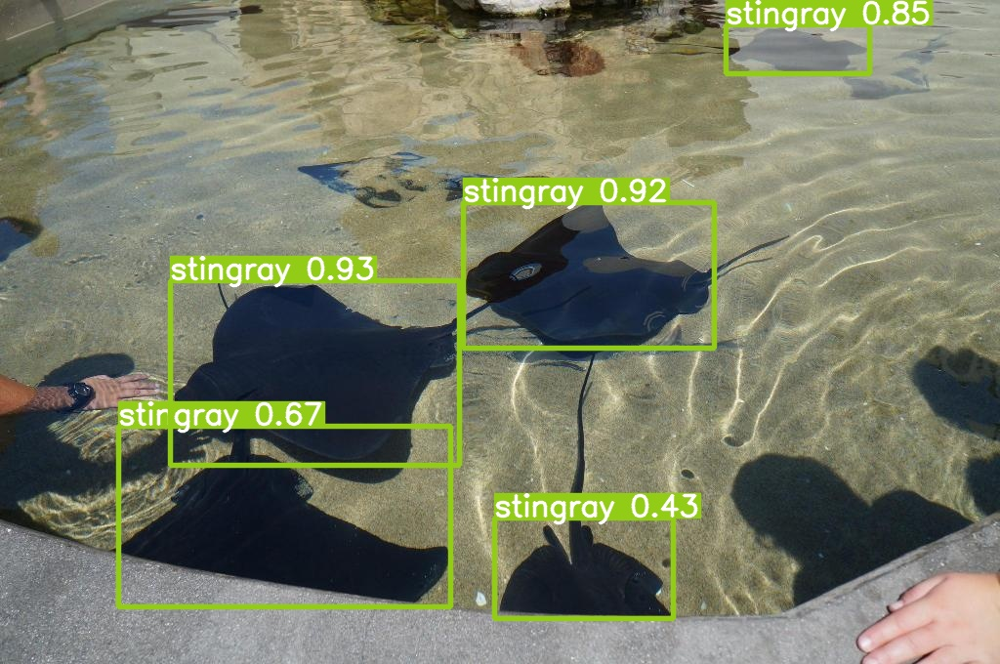

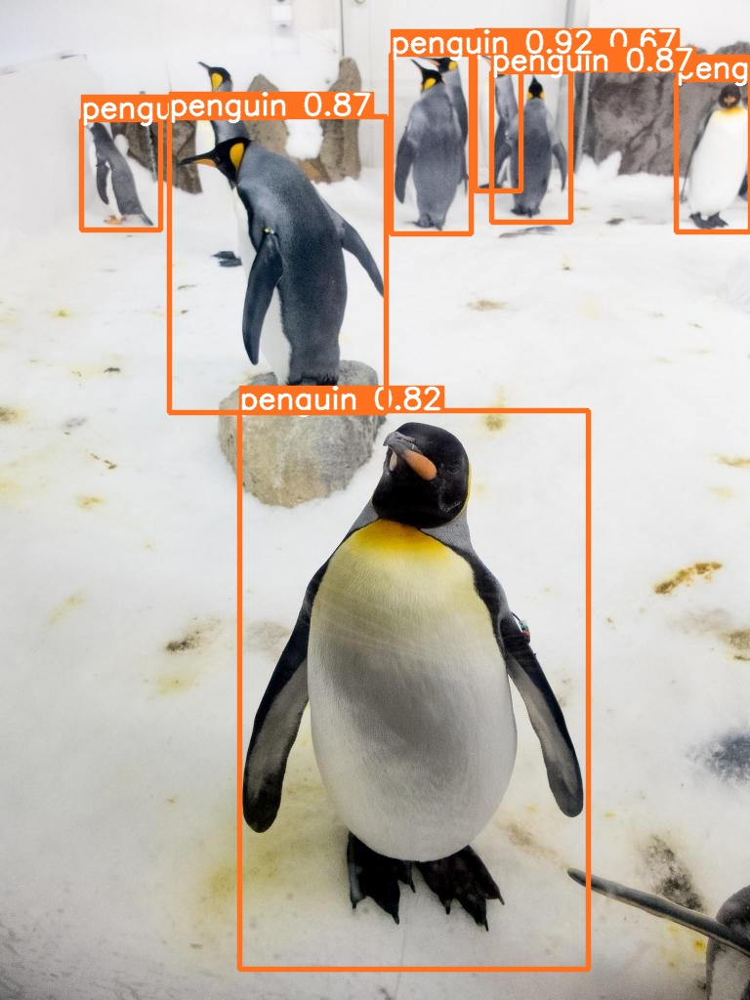

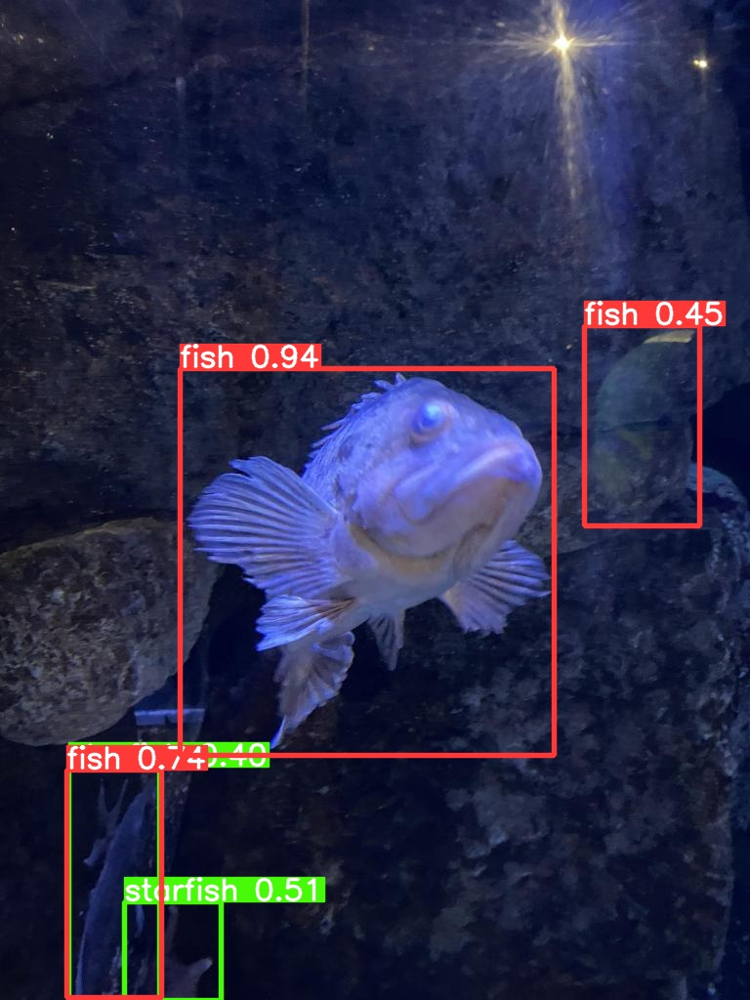

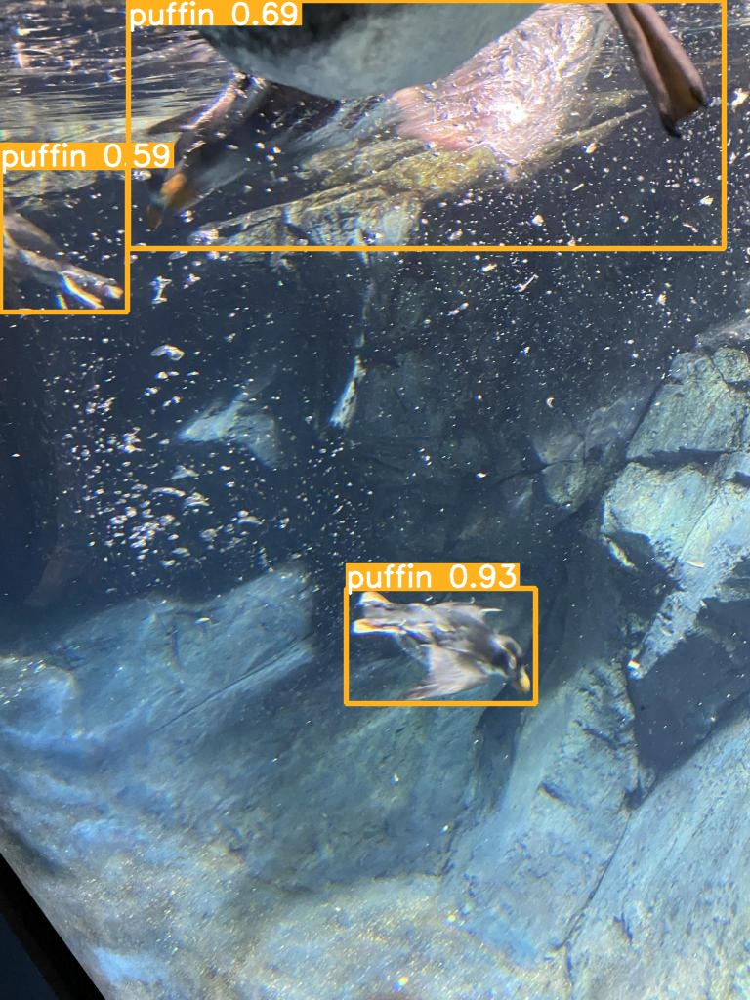

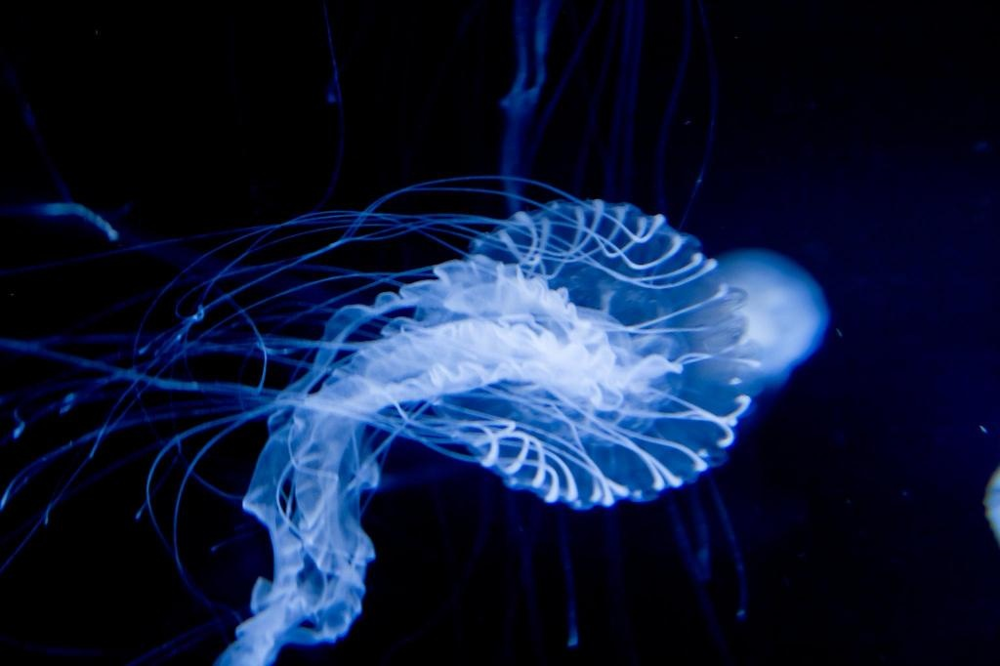

In [41]:
# Visualize five test images.
srti.visualize_test_imgs("models/runs/detect/results_yolo5m")

---------
#### **YOLO5m** (freezing layers)

In [42]:
%%time

# Folder for saving results.
# Freeze the model backbone (layers 0-9)
results_5m_fr = srti.set_results_dir("yolo5m_fr")

!python yolov5/train.py --data input/data/data.yaml --weights yolov5/yolov5m.pt \
    --img 640 --epochs {epochs} --batch-size {batch_size} --name {results_5m_fr} \
    --freeze 10 --cache --project {runs_train_dir} \
    --hyp yolov5/data/hyps/hyp.scratch-med.yaml

Outputs are saved to directory: results_yolo5m_fr ...
train: weights=yolov5/yolov5m.pt, cfg=, data=input/data/data.yaml, hyp=yolov5/data/hyps/hyp.scratch-med.yaml, epochs=40, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=models/runs/train/, name=results_yolo5m_fr, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[10], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-53-g65071da Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.3, cls_pw=1.0

Visualize training data

Ground truth augmented training data



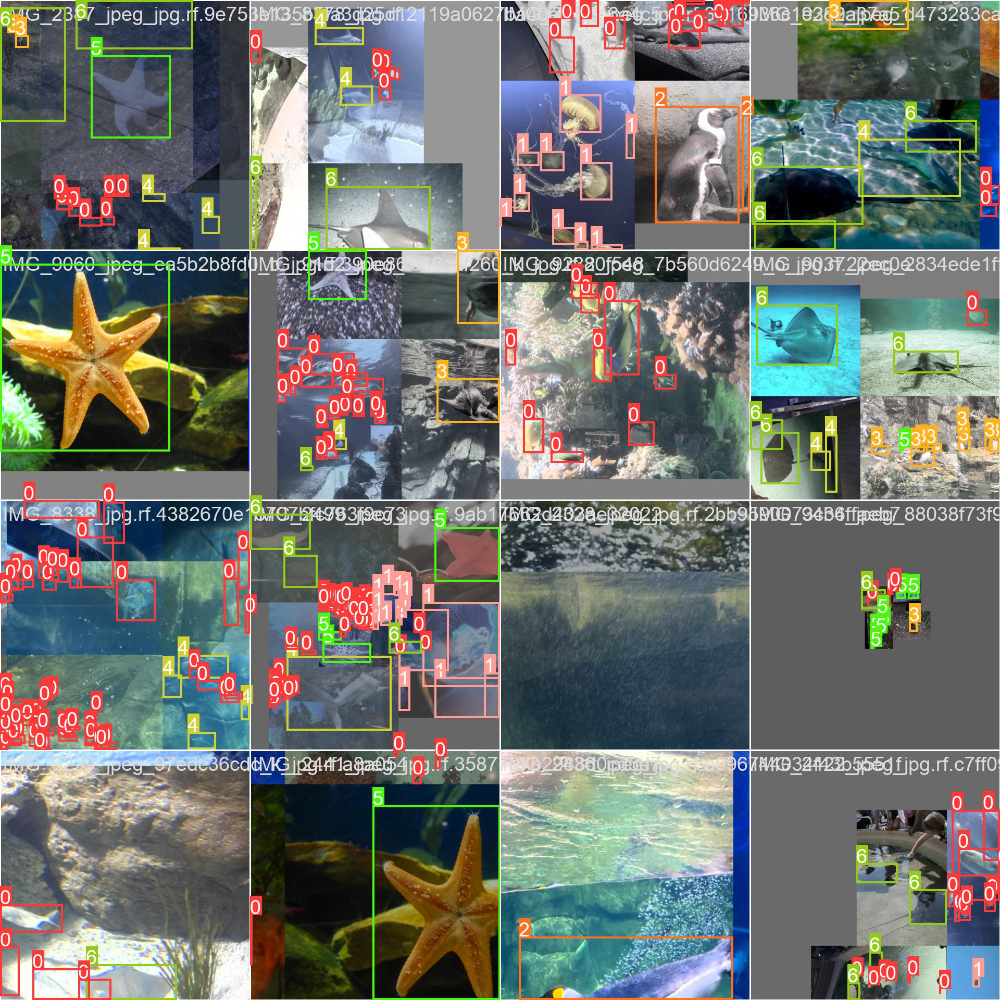

In [43]:
srti.visualize(results_5m_fr, 0, val=False)

Validation: ground truth data



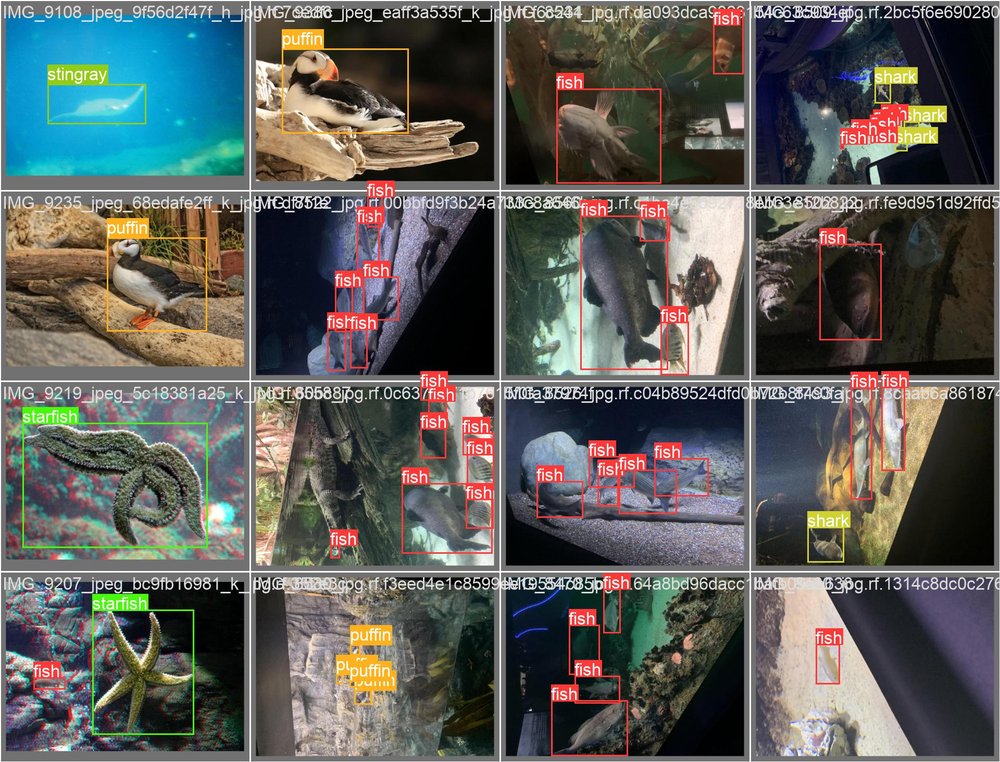

In [44]:
srti.visualize(results_5m_fr, 1, val=True)

Validation: predicted data



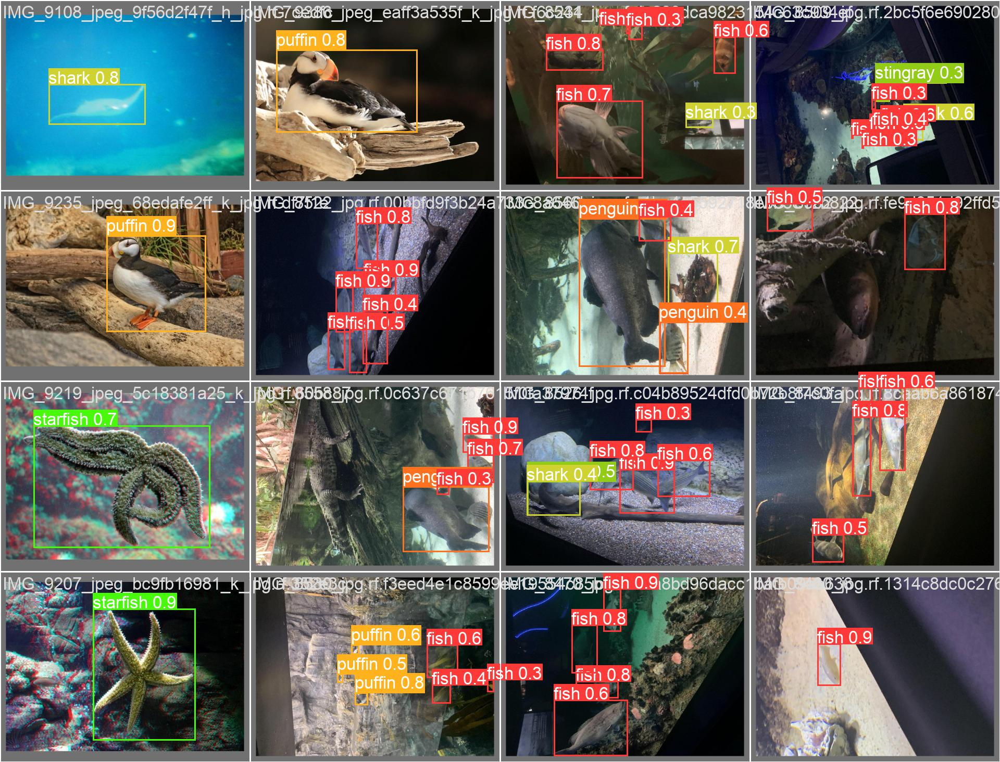

In [45]:
srti.visualize(results_5m_fr, 1, val=True, labels=False)

Save the best model

In [46]:
# Save the best model to models storage and return path.
model_yolo5m_fr = srti.move_best_model(results_5m_fr)

Inference on test

In [47]:
!python yolov5/detect.py --weights {model_yolo5m_fr} --source {test_imgs_dir} \
  --data input/data/data.yaml --img 640 --conf 0.4 --name {results_5m_fr} --project {runs_infer_dir}

detect: weights=['models/best_models_storage/best_yolo5m_fr.pt'], source=input/data/test/images/, data=input/data/data.yaml, imgsz=[640, 640], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=models/runs/detect/, name=results_yolo5m_fr, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-53-g65071da Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 20877180 parameters, 0 gradients, 47.9 GFLOPs
image 1/104 /content/drive/MyDrive/project_aquarium/input/data/test/images/IMG_2280_jpeg_jpg.rf.a0dff6c20b40fb134b7e26af712138a9.jpg: 640x480 61 fishs, 22.1ms
image 2/104 /content/drive/MyDrive/project_aquarium/input/data/test/images/IMG_2289_jpeg_jpg.rf.c1810d9dac260d89bdaa0dd693058115.jpg: 640x480 1 p

In [48]:
# Get the mAP.
!python yolov5/val.py --data input/data/data.yaml --weights {model_yolo5m_fr} \
  --batch-size 16 --task test --name test_mAP --project models/runs/detect/results_yolo5m_fr

val: data=input/data/data.yaml, weights=['models/best_models_storage/best_yolo5m_fr.pt'], batch_size=16, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=models/runs/detect/results_yolo5m_fr, name=test_mAP, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-53-g65071da Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 212 layers, 20877180 parameters, 0 gradients, 47.9 GFLOPs
test: Scanning /content/drive/MyDrive/project_aquarium/input/data/test/labels.cache... 104 images, 0 backgrounds, 0 corrupt: 100% 104/104 [00:00<?, ?it/s]
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 7/7 [00:05<00:00,  1.39it/s]
                   all        104        668      0.798      0.652      0.735      0.499
                  fish        104        322

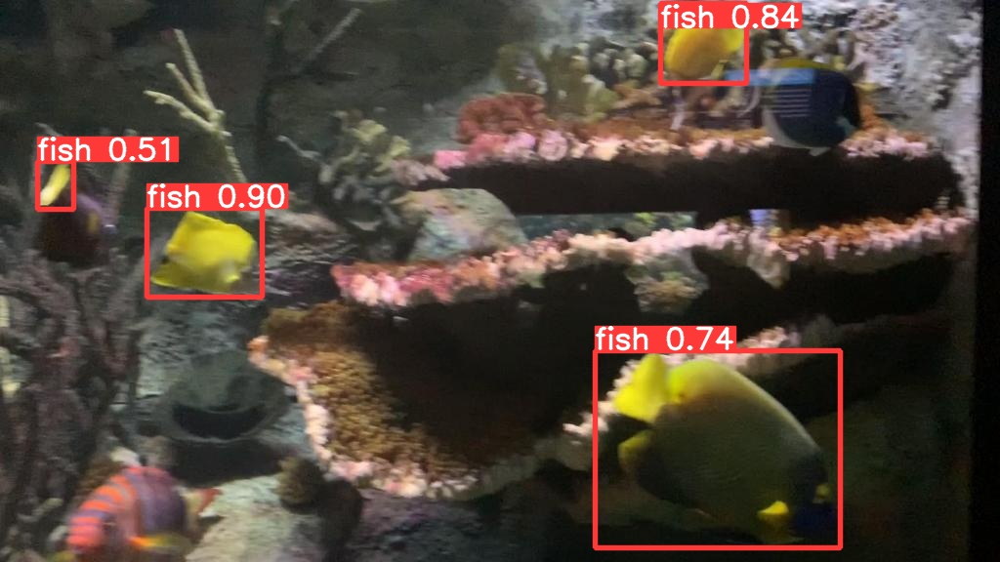

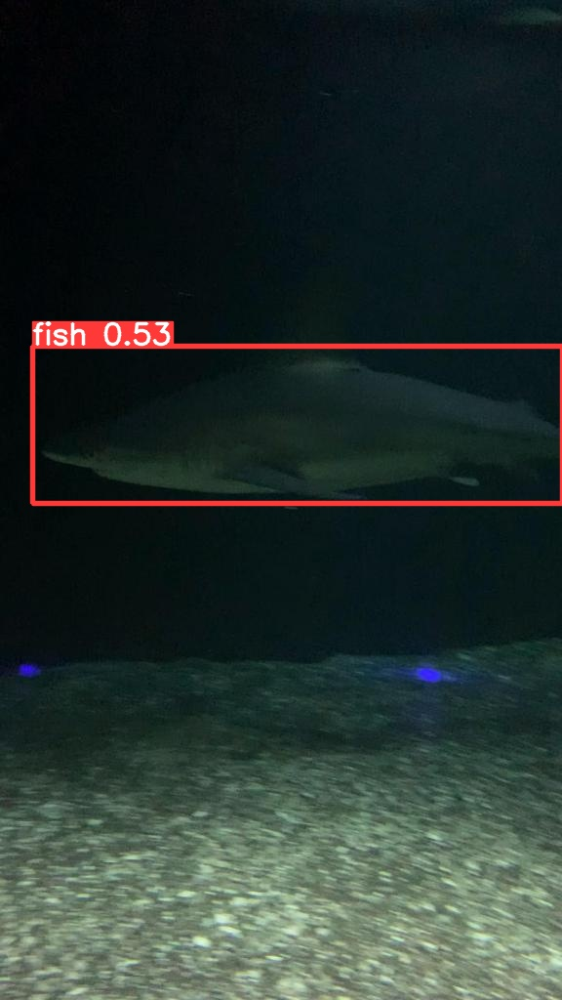

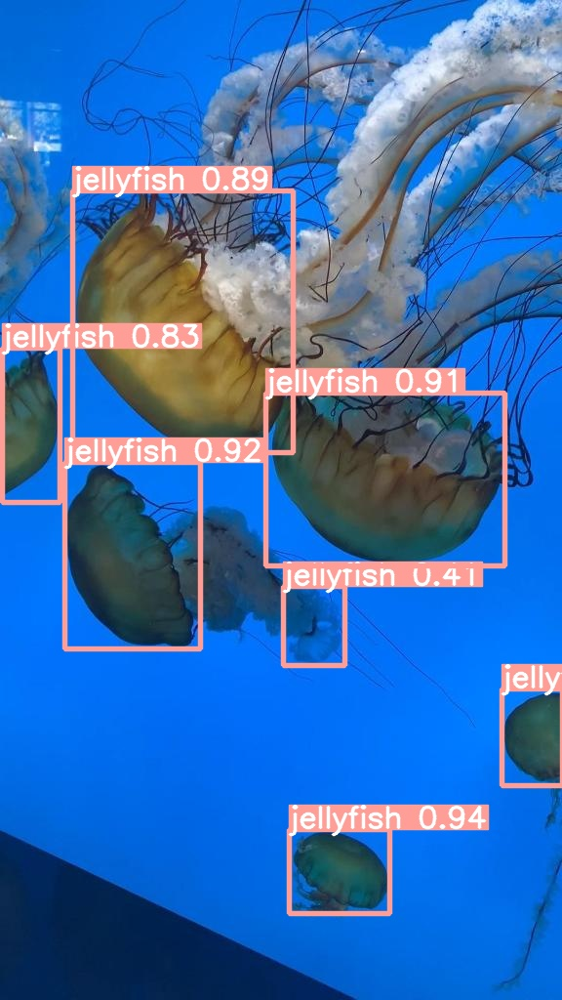

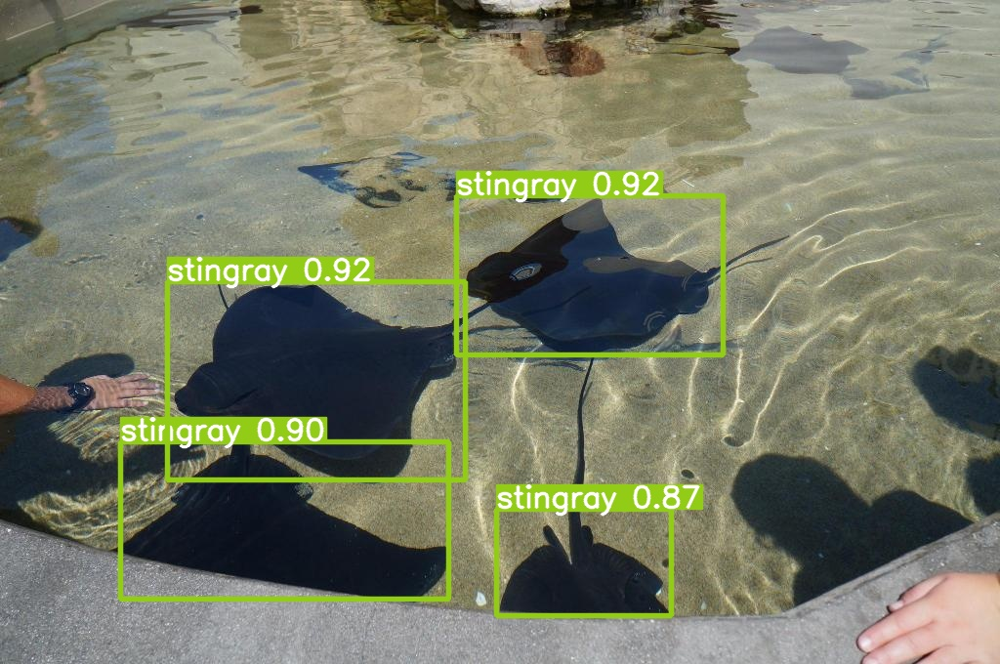

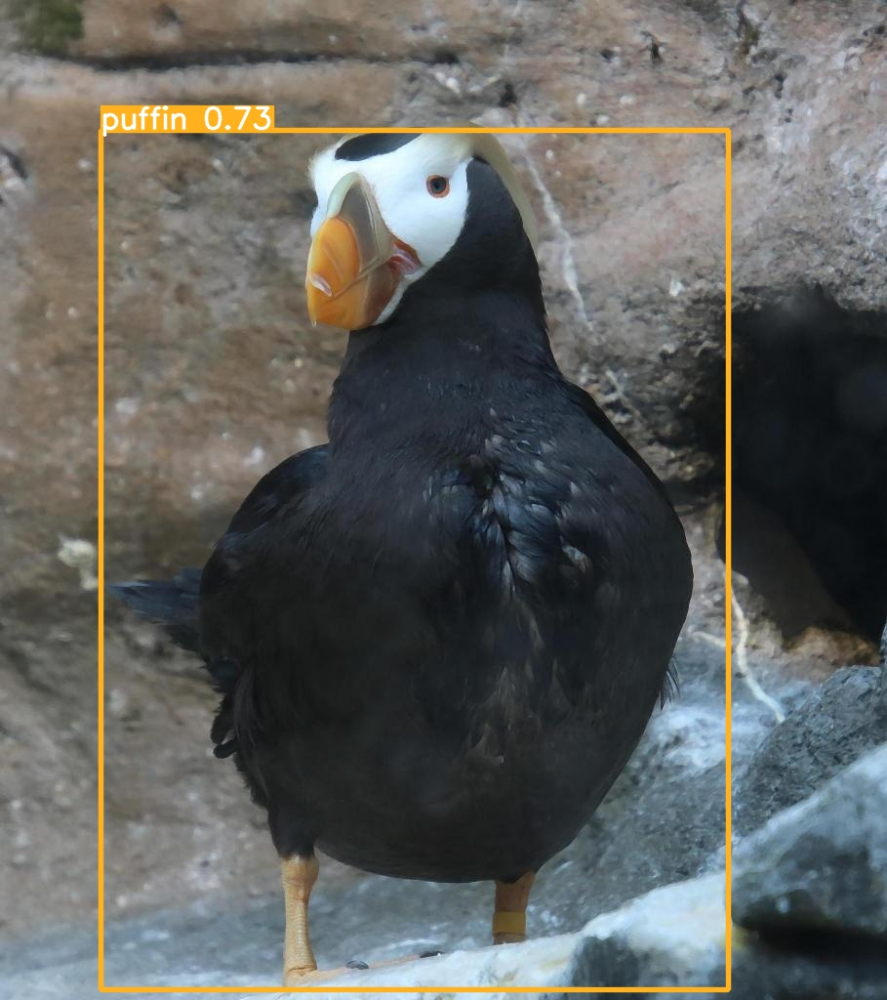

In [58]:
# Visualize five test images.
srti.visualize_test_imgs("models/runs/detect/results_yolo5m_fr")

---------
#### mAP values

In [1]:
path_5s = "../models/runs/train/results_yolo5s"
path_5m= "../models/runs/train/results_yolo5m"
path_5m_fr = "../models/runs/train/results_yolo5m_fr"

# Get the mAP values
m1, m2 = srti.get_max(os.path.join(path_5s, "results.csv"))
m3, m4 = srti.get_max(os.path.join(path_5m, "results.csv"))
m5, m6 = srti.get_max(os.path.join(path_5m_fr, "results.csv"))

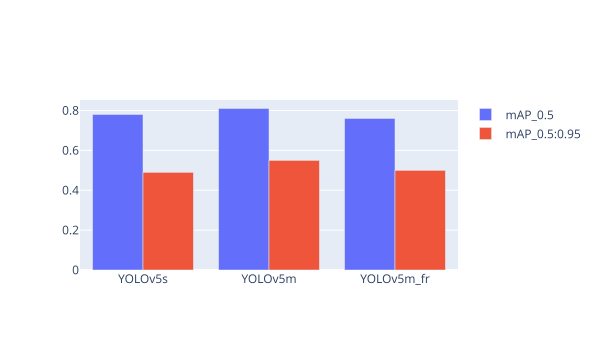

In [2]:
models = ["YOLOv5s", "YOLOv5m", "YOLOv5m_fr"]

fig = go.Figure(data=[
    go.Bar(name="mAP_0.5", x=models, y=[m1, m3, m5]),
    go.Bar(name="mAP_0.5:0.95", x=models, y=[m2, m4, m6])
])

fig.update_layout(barmode="group",
                  width=600,
                  height=350)
fig.show('svg')
fig.write_image("imgs/mAPs.png")

---------
#### Inference on video with the best model

In [ ]:
!python yolov5/detect.py --weights {model_yolo5m} --source input/inference/video_1.mp4 \
  --img 640 --conf 0.4 --name video_aquarium --project models/runs/detect/results_yolo5m

In [61]:
srti.visualize_video("models/runs/detect/results_yolo5m/video_aquarium", "video_1")

In [ ]:
!python yolov5/detect.py --weights {model_yolo5m} --source input/inference/starfish.mp4 \
  --img 640 --conf 0.4 --name video_starfish --project models/runs/detect/results_yolo5m

In [63]:
srti.visualize_video("models/runs/detect/results_yolo5m/video_starfish", "starfish")